In [1]:
import re
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision import datasets
from PIL import Image

import os
from os import listdir
from os.path import isfile, join
import string
import matplotlib.pyplot as plt

from skimage.feature import local_binary_pattern, hog

In [2]:
train_data = datasets.ImageFolder('ufi-cropped/train', transform=transforms.ToTensor())

test_data = datasets.ImageFolder('ufi-cropped/test', transform=transforms.ToTensor())

In [3]:
train_data, test_data

(Dataset ImageFolder
     Number of datapoints: 4316
     Root Location: ufi-cropped/train
     Transforms (if any): ToTensor()
     Target Transforms (if any): None, Dataset ImageFolder
     Number of datapoints: 605
     Root Location: ufi-cropped/test
     Transforms (if any): ToTensor()
     Target Transforms (if any): None)

In [4]:
train_loader = torch.utils.data.DataLoader(dataset=train_data,
                                         batch_size=32)
test_loader = torch.utils.data.DataLoader(dataset=test_data,
                                         batch_size=32)

In [5]:
#sample batch check
data_iter = iter(train_loader)
X_, Y_ = data_iter.next()

X_.size(), Y_.size()

(torch.Size([32, 3, 128, 128]), torch.Size([32]))

In [6]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
use_cuda = True

In [7]:
os.environ['TORCH_MODEL_ZOO'] = 'E:\\College\\Final Year Project\\models'
model_pre = torchvision.models.resnet50(pretrained=True)

In [8]:
from collections import OrderedDict


classifier = nn.Sequential(OrderedDict([
                          ('fc1', nn.Linear(8192, 2048)),
                          ('relu1', nn.ReLU()),
                          ('dropout1', nn.Dropout(0.5)),
                          ('fc2', nn.Linear(2048, 1024)),
                          ('relu2', nn.ReLU()),
                          ('dropout2', nn.Dropout(0.5)),
                          ('output', nn.Linear(1024, 605))
                          ])) 
model_pre.avgpool = nn.AvgPool2d(kernel_size=3, stride=1, padding=0)
model_pre.fc = classifier

In [9]:
model_pre.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [10]:
# load the model that got the best validation accuracy
model_pre.load_state_dict(torch.load('model.pt'))

In [11]:
model_conv = nn.Sequential(*list(model_pre.children())[:-1])

In [12]:
X, Y = [], []
for (data, target) in train_loader:
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()

        features = model_conv(data)
        features = features.view(-1, 8192)
        X.append((features).detach().cpu().numpy())
        Y.append((target).cpu().numpy())
        

In [13]:
np.asarray(X).shape, np.asarray(Y).shape

((135,), (135,))

In [15]:
x_train = np.asarray(X[0])
for arr in X[1:]:
    x_train = np.vstack((x_train, arr))

y_train = np.asarray(Y[0])
for arr in Y[1:]:
    y_train = np.hstack((y_train, arr))

In [16]:
x_train.shape, y_train.shape

((4316, 8192), (4316,))

In [17]:
from sklearn.svm import SVC
clf = SVC(kernel = 'linear')
clf.fit(x_train, y_train)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

In [18]:
clf.score(x_train, y_train)

1.0

In [19]:
X, Y = [], []
for (data, target) in test_loader:
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()

        features = model_conv(data)
        features = features.view(-1, 8192)
        X.append((features).detach().cpu().numpy())
        Y.append((target).cpu().numpy())
        

In [20]:
np.asarray(X).shape, np.asarray(Y).shape

((19,), (19,))

In [22]:
x_test = np.asarray(X[0])
for arr in X[1:]:
    x_test = np.vstack((x_test, arr))

y_test = np.asarray(Y[0])
for arr in Y[1:]:
    y_test = np.hstack((y_test, arr))

In [23]:
x_test.shape, y_test.shape

((605, 8192), (605,))

In [24]:
clf.score(x_test, y_test)

0.6016528925619835

In [36]:
class_names = os.listdir('ufi-cropped/test')

test_filenames = []
for class_name in class_names:
    test_filenames.append(os.path.join('ufi-cropped/test/'+ class_name + '/', os.listdir('ufi-cropped/test/'+ class_name)[0]))

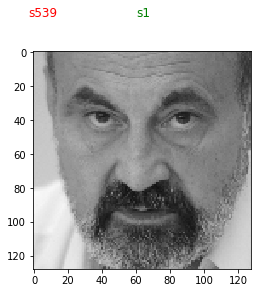

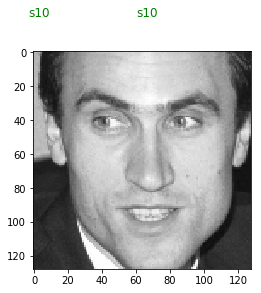

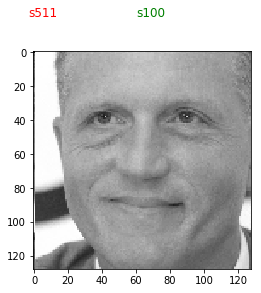

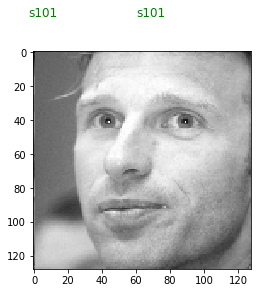

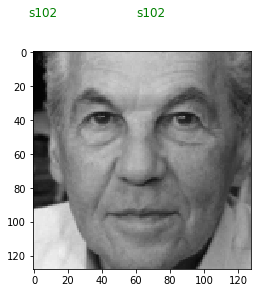

...

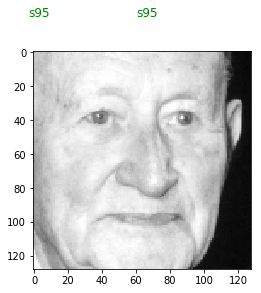

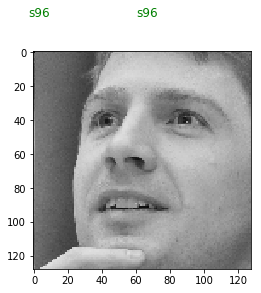

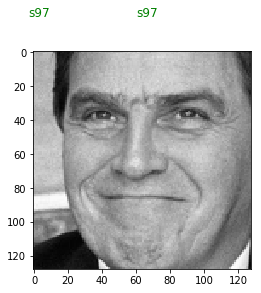

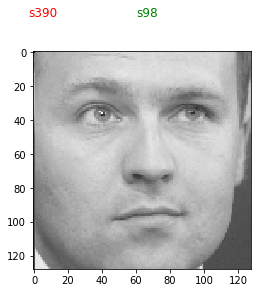

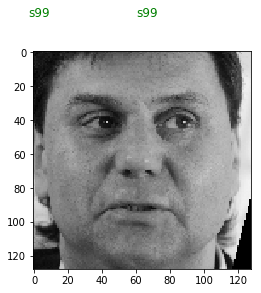

In [39]:
for label, path in zip(class_names, test_filenames):    
    pred = predict(path)
    plt.imshow(Image.open(path), cmap=plt.cm.gray)
    if (pred == label):
        plt.gcf().text(0.25, 1, pred, fontsize=12, color='green')
        plt.gcf().text(0.5, 1, label, fontsize=12, color='green')
    else:
        plt.gcf().text(0.25, 1, pred, fontsize=12, color='red')
        plt.gcf().text(0.5, 1, label, fontsize=12, color='green')
    plt.show()